#Set up TensorFlow

#Import Google Drive

In [213]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [214]:
import tensorflow as tf
print("TensorFlow version:", tf.__version__)

TensorFlow version: 2.12.0


#Installing Dependency

In [215]:
# Use seaborn for pairplot.
!pip install -q seaborn

#Import Library

In [216]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# Make NumPy printouts easier to read.
np.set_printoptions(precision=5, suppress=True)

#Import Keras

In [217]:
from tensorflow import keras
from tensorflow.keras import layers

##Setup path

In [218]:
path='drive/MyDrive/Internship Data/'

#Get the Data

In [219]:
#dataset 1
dataset=pd.read_csv(path+"SET 1 APRIL 23.csv",names=["Time", "Tag1", "Tag2","Tag3", "Tag4","Tag5", "Tag6","Tag7"])
dataset2=pd.read_csv(path+"SET 1 DEC 22.csv",names=["Time", "Tag1", "Tag2","Tag3", "Tag4","Tag5", "Tag6","Tag7"])
dataset_1=pd.concat([dataset,dataset2],ignore_index=True)
dataset_1.tail()

,Time,Tag1,Tag2,Tag3,Tag4,Tag5,Tag6,Tag7
18596,2022/12/18 01:49:20.000 AM - 2022/12/18 01:49:...,56.129105,69.86904,38.095364,38.082430,97.62661,95.01935,94.99300
18597,2022/12/18 01:49:30.000 AM - 2022/12/18 01:49:...,56.121380,69.86904,38.095364,38.082430,97.62661,94.88069,94.99300
18598,2022/12/18 01:49:40.000 AM - 2022/12/18 01:49:...,56.103100,69.86904,38.095364,38.148810,97.62661,94.71660,94.97305
18599,2022/12/18 01:49:50.000 AM - 2022/12/18 01:50:...,56.103100,69.86904,38.095364,38.172993,97.62661,94.71660,94.79557
18600,2022/12/18 01:50:00.000 AM - 2022/12/18 01:50:...,56.103100,69.86904,38.095364,38.172993,97.48119,94.71660,94.79557


In [220]:
#Dataset2
temp1=pd.read_csv(path+"SET 2 APRIL 23.csv",names=["Time", "Tag8", "Tag9","Tag10", "Tag11","Tag12", "Tag13","Tag14"])
temp1.pop("Tag14")
temp2=pd.read_csv(path+"SET 2 DEC 22.csv",names=["Time", "Tag8", "Tag9","Tag10", "Tag11","Tag12", "Tag13"])
dataset_2=pd.concat([temp1,temp2],ignore_index=True)
dataset_2.tail()

,Time,Tag8,Tag9,Tag10,Tag11,Tag12,Tag13
18597,2022/12/18 01:49:20.000 AM - 2022/12/18 01:49:...,6897.6113,0.58309,6.477310,2.027778,9.933843,3.535333
18598,2022/12/18 01:49:30.000 AM - 2022/12/18 01:49:...,6891.4650,0.58309,7.042778,2.027778,9.050926,4.217593
18599,2022/12/18 01:49:40.000 AM - 2022/12/18 01:49:...,6890.1250,0.58309,7.211357,2.027778,9.050926,4.217593
18600,2022/12/18 01:49:50.000 AM - 2022/12/18 01:50:...,6890.1250,0.58309,6.906560,2.027778,9.050926,4.217593
18601,2022/12/18 01:50:00.000 AM - 2022/12/18 01:50:...,6890.1250,0.58309,6.925389,2.027778,9.050926,4.217593


In [221]:
#Dataset 3
temp1=pd.read_csv(path+"SET 3 APRIL 23.csv",names=["Time", "Tag14", "Tag15","Tag16", "Tag17","Tag18", "Tag19","Tag20"])
temp2=pd.read_csv(path+"SET 3 DEC 22.csv",names=["Time", "Tag14", "Tag15","Tag16", "Tag17","Tag18", "Tag19","Tag20"])
dataset_3=pd.concat([temp1,temp2],ignore_index=True)
dataset_3.tail()

,Time,Tag14,Tag15,Tag16,Tag17,Tag18,Tag19,Tag20
18597,2022/12/18 01:49:20.000 AM - 2022/12/18 01:49:...,3021.4277,66.84097,50.617146,131.00848,136.15118,61.851852,0.034722
18598,2022/12/18 01:49:30.000 AM - 2022/12/18 01:49:...,3023.4019,66.84097,50.635418,131.00848,136.15118,61.851852,0.034722
18599,2022/12/18 01:49:40.000 AM - 2022/12/18 01:49:...,3035.8374,66.84097,50.683830,131.00848,136.15118,61.851852,0.034722
18600,2022/12/18 01:49:50.000 AM - 2022/12/18 01:50:...,3035.8374,66.84097,50.686110,130.80287,136.15118,62.201294,0.034722
18601,2022/12/18 01:50:00.000 AM - 2022/12/18 01:50:...,3035.8374,66.84097,50.686110,130.72210,136.15118,62.407406,0.034722


In [222]:
#Dataset 4
temp1=pd.read_csv(path+"SET 4 APRIL 23.csv",names=["Time", "Tag21", "Tag22","Tag23", "Tag24","Tag25", "Tag26","Tag27"])
temp2=pd.read_csv(path+"SET 4 DEC 22.csv",names=["Time", "Tag21", "Tag22","Tag23", "Tag24","Tag25", "Tag26","Tag27"])
dataset_4=pd.concat([temp1,temp2],ignore_index=True)
dataset_4.tail()

,Time,Tag21,Tag22,Tag23,Tag24,Tag25,Tag26,Tag27
18597,2022/12/18 01:49:20.000 AM - 2022/12/18 01:49:...,0.410972,31.46584,48.647655,195.74857,10.490327,146.63484,-37.463867
18598,2022/12/18 01:49:30.000 AM - 2022/12/18 01:49:...,0.410972,31.38426,48.935184,195.74857,10.490972,146.63484,-37.463867
18599,2022/12/18 01:49:40.000 AM - 2022/12/18 01:49:...,0.410972,31.38426,48.861980,195.74857,10.490972,146.63484,-39.263160
18600,2022/12/18 01:49:50.000 AM - 2022/12/18 01:50:...,0.410972,31.38426,49.227467,195.74857,10.490972,146.83136,-40.177734
18601,2022/12/18 01:50:00.000 AM - 2022/12/18 01:50:...,0.410972,31.38426,48.727592,195.74857,10.490972,146.91680,-40.177734


##Merge The Data

In [223]:
dataset=pd.merge(dataset_1,dataset_2,on="Time")
dataset=pd.merge(dataset,dataset_3,on="Time")
dataset=pd.merge(dataset,dataset_4,on="Time")
dataset.tail()

,Time,Tag1,Tag2,Tag3,Tag4,Tag5,Tag6,Tag7,Tag8,Tag9,...,Tag18,Tag19,Tag20,Tag21,Tag22,Tag23,Tag24,Tag25,Tag26,Tag27
18596,2022/12/18 01:49:20.000 AM - 2022/12/18 01:49:...,56.129105,69.86904,38.095364,38.082430,97.62661,95.01935,94.99300,6897.6113,0.58309,...,136.15118,61.851852,0.034722,0.410972,31.46584,48.647655,195.74857,10.490327,146.63484,-37.463867
18597,2022/12/18 01:49:30.000 AM - 2022/12/18 01:49:...,56.121380,69.86904,38.095364,38.082430,97.62661,94.88069,94.99300,6891.4650,0.58309,...,136.15118,61.851852,0.034722,0.410972,31.38426,48.935184,195.74857,10.490972,146.63484,-37.463867
18598,2022/12/18 01:49:40.000 AM - 2022/12/18 01:49:...,56.103100,69.86904,38.095364,38.148810,97.62661,94.71660,94.97305,6890.1250,0.58309,...,136.15118,61.851852,0.034722,0.410972,31.38426,48.861980,195.74857,10.490972,146.63484,-39.263160
18599,2022/12/18 01:49:50.000 AM - 2022/12/18 01:50:...,56.103100,69.86904,38.095364,38.172993,97.62661,94.71660,94.79557,6890.1250,0.58309,...,136.15118,62.201294,0.034722,0.410972,31.38426,49.227467,195.74857,10.490972,146.83136,-40.177734
18600,2022/12/18 01:50:00.000 AM - 2022/12/18 01:50:...,56.103100,69.86904,38.095364,38.172993,97.48119,94.71660,94.79557,6890.1250,0.58309,...,136.15118,62.407406,0.034722,0.410972,31.38426,48.727592,195.74857,10.490972,146.91680,-40.177734


#Clean the data

In [224]:
#Remove Time
dataset=dataset.drop('Time',axis=1)
print(dataset.isna().sum())

Tag1     0
Tag2     0
Tag3     0
Tag4     0
Tag5     0
Tag6     0
Tag7     0
Tag8     0
Tag9     0
Tag10    0
Tag11    0
Tag12    0
Tag13    0
Tag14    0
Tag15    0
Tag16    0
Tag17    0
Tag18    0
Tag19    0
Tag20    0
Tag21    0
Tag22    0
Tag23    0
Tag24    0
Tag25    0
Tag26    0
Tag27    0
dtype: int64


In [225]:
#Remove garbase data
for cols in dataset.columns:
  dataset = dataset[pd.to_numeric(dataset[cols], errors='coerce').notna()]

#Split the data into training and test sets

In [226]:
train_dataset = dataset.sample(frac=0.8, random_state=0)
test_dataset = dataset.drop(train_dataset.index)

#Necessary column

In [227]:
columns=[]
for i in range(1,28):
  columns.append('Tag'+str(i))
print(columns)

['Tag1', 'Tag2', 'Tag3', 'Tag4', 'Tag5', 'Tag6', 'Tag7', 'Tag8', 'Tag9', 'Tag10', 'Tag11', 'Tag12', 'Tag13', 'Tag14', 'Tag15', 'Tag16', 'Tag17', 'Tag18', 'Tag19', 'Tag20', 'Tag21', 'Tag22', 'Tag23', 'Tag24', 'Tag25', 'Tag26', 'Tag27']


#Inspect The Data

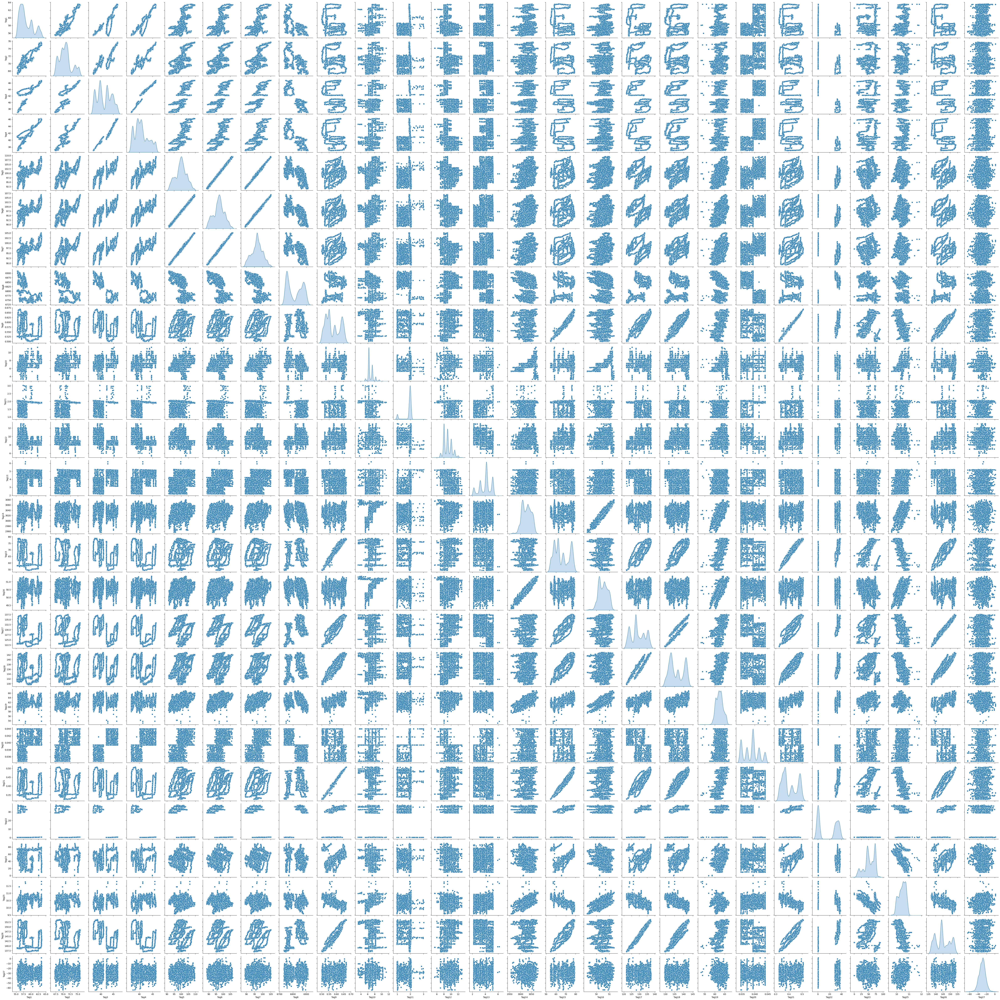

In [242]:
sns.pairplot(train_dataset[columns], diag_kind='kde')

Describe The Corelation

In [229]:
train_dataset.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Tag1,14879.0,58.321272,2.239848,55.231613,56.547066,57.565258,60.026140,63.617750
Tag2,14879.0,70.740882,2.094897,67.100845,69.320450,70.609540,71.606880,75.778800
Tag3,14879.0,41.443199,2.835954,36.892265,39.363613,41.033802,44.078503,46.866540
Tag4,14879.0,40.828519,2.492122,36.969868,39.040035,40.476974,42.640015,46.282810
Tag5,14879.0,99.867932,3.823382,91.256890,97.600280,100.011850,102.332880,109.438000
Tag6,14879.0,97.067135,3.739021,88.628365,94.861370,97.231450,99.510970,106.715640
Tag7,14879.0,96.639877,3.324898,89.075060,94.584980,96.742630,98.786080,105.051605
Tag8,14879.0,6815.192327,56.541789,6732.000000,6758.736300,6817.242700,6872.250000,6912.430700
Tag9,14879.0,0.576250,0.048670,0.500521,0.533576,0.555541,0.628437,0.668160
Tag10,14879.0,6.771502,0.849757,3.208333,6.287037,6.342593,7.277778,11.291667


<ipython-input-230-a9a1e82bf591>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = train_dataset.corr()


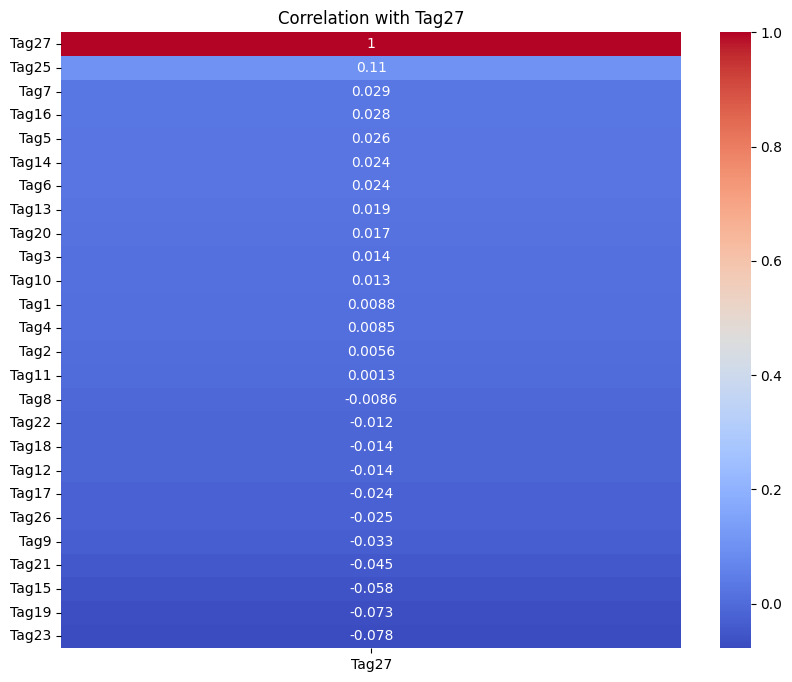

In [230]:
import matplotlib.pyplot as plt

# Calculate the correlation matrix
corr_matrix = train_dataset.corr()

# Select the column of interest
column_of_interest = 'Tag27'

# Extract the correlation values for the column of interest
column_correlations = corr_matrix[column_of_interest].values.reshape(-1, 1)

# Sort the correlation values in descending order
sorted_indices = (-column_correlations).argsort(axis=0)
column_correlations_sorted = column_correlations[sorted_indices]
# Reshape the sorted correlations array to 2 dimensions
column_correlations_sorted = column_correlations_sorted.reshape(-1, 1)
# Create a correlation matrix heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(column_correlations_sorted, annot=True, cmap='coolwarm', xticklabels=[column_of_interest],
            yticklabels=corr_matrix.index[sorted_indices.flatten()])
plt.title('Correlation with {}'.format(column_of_interest))
plt.show()

#Split Feature From labels

In [231]:
train_features = train_dataset.copy()
test_features = test_dataset.copy()
#Pop out the unnecessary labels
# Select the columns of interest
columns_of_interest = ['Tag1', 'Tag2', 'Tag3', 'Tag4', 'Tag5', 'Tag6', 'Tag7', 'Tag8', 'Tag9', 'Tag10',
                       'Tag11', 'Tag12', 'Tag13', 'Tag14', 'Tag15', 'Tag16', 'Tag17', 'Tag18', 'Tag19',
                       'Tag20', 'Tag21', 'Tag22', 'Tag23', 'Tag24', 'Tag25', 'Tag26', 'Tag27']

# Calculate the correlation matrix
correlation_matrix = train_dataset[columns_of_interest].corr()

# Get the correlation values for 'Tag27' with other columns
correlation_with_tag27 = correlation_matrix['Tag27']

# Select features based on correlation threshold
correlation_threshold = 0.02
selected_features = correlation_with_tag27[abs(correlation_with_tag27) >= correlation_threshold]

# Print the selected features
print(selected_features)

# Identify the columns with low correlation
low_correlation_columns = []
for column in correlation_matrix.columns:
    if abs(correlation_with_tag27[column]) < correlation_threshold:
        low_correlation_columns.append(column)
print(low_correlation_columns)
# Remove the low correlation columns from train_features and test_features
train_features = train_features.drop(low_correlation_columns, axis=1)
test_features = test_features.drop(low_correlation_columns, axis=1)
train_labels = train_features.pop('Tag27')
test_labels = test_features.pop('Tag27')

Tag5     0.025903
Tag6     0.023741
Tag7     0.029247
Tag9    -0.033013
Tag14    0.024045
Tag15   -0.058465
Tag16    0.027658
Tag17   -0.024101
Tag19   -0.073197
Tag21   -0.044796
Tag23   -0.077827
Tag25    0.107112
Tag26   -0.025391
Tag27    1.000000
Name: Tag27, dtype: float64
['Tag1', 'Tag2', 'Tag3', 'Tag4', 'Tag8', 'Tag10', 'Tag11', 'Tag12', 'Tag13', 'Tag18', 'Tag20', 'Tag22']


<ipython-input-231-0633aed56ea9>:10: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = train_dataset[columns_of_interest].corr()


#Normalization and Normalization Layer

In [232]:
train_features.describe().transpose()[['mean', 'std']]

,mean,std
Tag5,99.867932,3.823382
Tag6,97.067135,3.739021
Tag7,96.639877,3.324898
Tag9,0.576250,0.048670
Tag14,3027.595401,20.658948
Tag15,65.780116,7.507395
Tag16,50.515482,0.343030
Tag17,129.097786,4.487928
Tag19,62.358262,1.701621
Tag21,0.406352,0.056523


In [233]:
normalizer = tf.keras.layers.Normalization(axis=-1)

In [234]:
normalizer.adapt(np.array(train_features).astype('float32'))

#Build The kERAs sequential model

In [243]:
from tensorflow.keras import initializers
model=tf.keras.Sequential([
    normalizer,
    layers.Dense(16,activation='relu',kernel_initializer=initializers.RandomNormal(stddev=.01)),
    #layers.Dropout(0.1),
    # layers.Dense(16,activation='tanh',kernel_initializer=initializers.RandomNormal(stddev=1)),
    layers.Dense(4,activation='tanh',kernel_initializer=initializers.RandomNormal(stddev=1)),
    layers.Dense(1)
])
model.summary()

In [244]:
#Compile
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),
    #tf.keras.optimizers.schedules.PiecewiseConstantDecay(),
    loss='mean_squared_error')

In [245]:
train_labels=np.array(train_labels).astype('float32')
train_features=np.array(train_features).astype('float32')

In [246]:
history = model.fit(
    train_features,
    train_labels,
    batch_size=32,
    epochs=20,
    verbose=2,
    # Calculate validation results on 20% of the training data.
    validation_split = 0.2)

Epoch 1/20
372/372 - 2s - loss: 431.4585 - val_loss: 183.4811 - 2s/epoch - 5ms/step
Epoch 2/20
372/372 - 1s - loss: 106.0520 - val_loss: 65.7205 - 777ms/epoch - 2ms/step
Epoch 3/20
372/372 - 1s - loss: 60.4620 - val_loss: 55.8448 - 795ms/epoch - 2ms/step
Epoch 4/20
372/372 - 1s - loss: 57.6927 - val_loss: 55.3994 - 908ms/epoch - 2ms/step
Epoch 5/20
372/372 - 1s - loss: 57.5829 - val_loss: 55.2688 - 1s/epoch - 3ms/step
Epoch 6/20
372/372 - 1s - loss: 56.8243 - val_loss: 58.7936 - 901ms/epoch - 2ms/step
Epoch 7/20
372/372 - 1s - loss: 56.3895 - val_loss: 54.1452 - 792ms/epoch - 2ms/step
Epoch 8/20
372/372 - 1s - loss: 55.3937 - val_loss: 53.2013 - 561ms/epoch - 2ms/step
Epoch 9/20
372/372 - 1s - loss: 54.5069 - val_loss: 53.3419 - 506ms/epoch - 1ms/step
Epoch 10/20
372/372 - 1s - loss: 54.4354 - val_loss: 53.1613 - 545ms/epoch - 1ms/step
Epoch 11/20
372/372 - 1s - loss: 54.0365 - val_loss: 52.3859 - 573ms/epoch - 2ms/step
Epoch 12/20
372/372 - 1s - loss: 53.8761 - val_loss: 52.5863 - 558

#Evaluate the test set

In [239]:
#Evaluate
results=model.evaluate(np.array(test_features).astype('float32'),np.array(test_labels).astype('float32'))
print(results)

117/117 [==============================] - 0s 2ms/step - loss: 51.0290
51.028961181640625


In [240]:
test_results = model.predict(
    np.array(test_features).astype('float32'))

117/117 [==============================] - 0s 2ms/step


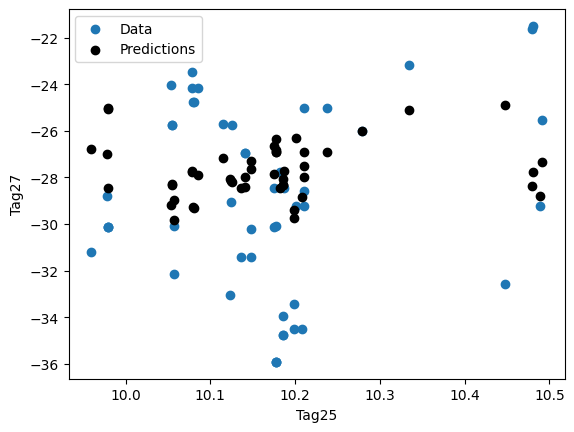

In [247]:
plt.scatter(test_features['Tag25'][:50], test_labels[:50], label='Data')
plt.scatter(test_features['Tag25'][:50],test_results[0:50], color='k', label='Predictions')
plt.xlabel('Tag25')
plt.ylabel('Tag27')
plt.legend()